# Analysis
In this notebook I analyze all the data collected through the iterations for the reinforcement TICA 

### Import needed modules and useful functions

In [1]:
#-- useful python script for training the DeepTICA cvs --#
from utils import *

#-- to not visualize warnings --#
import warnings
warnings.filterwarnings('ignore')

### Simulation parameters 

In [2]:
iterations = 10 # non è arrivato fino al 30. Errore con la Barrier

kb=0.008314
#-- SIMULATION PARAMETERS --#
sim_parameters = {
    'temp':340, 
    'beta': 1./(340*kb),
    'kbt': None,
    #-- parameters to compute the fes --#
    'blocks':2,
    'bandwidth': 0.02,
    'plot_max_fes' :10,
}
#--------------------------------------#


# Results

In [3]:
List =[]
root = "all_data_unbias/"
folder = root+"unbias/"
for i in range(1,iterations):
    List.append(folder)
    folder += "bias"+str(i)+"/"
List.append(folder)

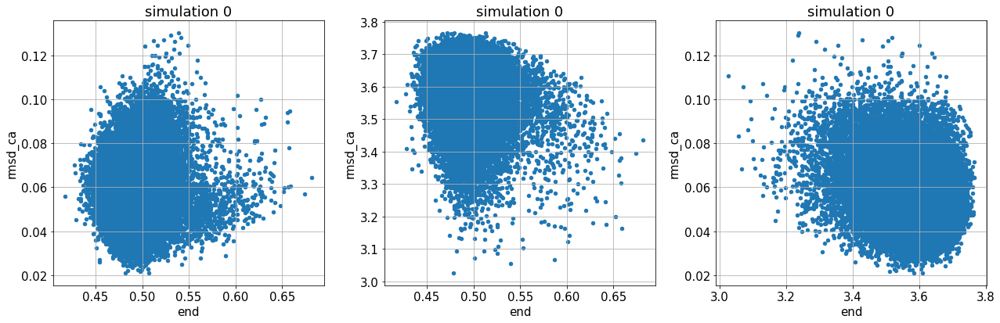

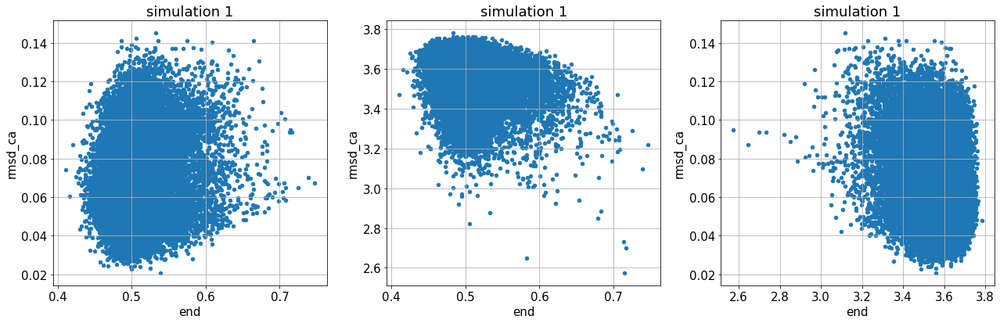

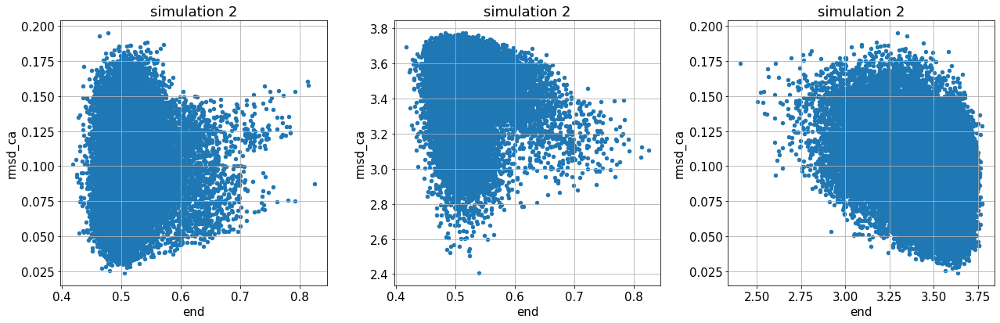

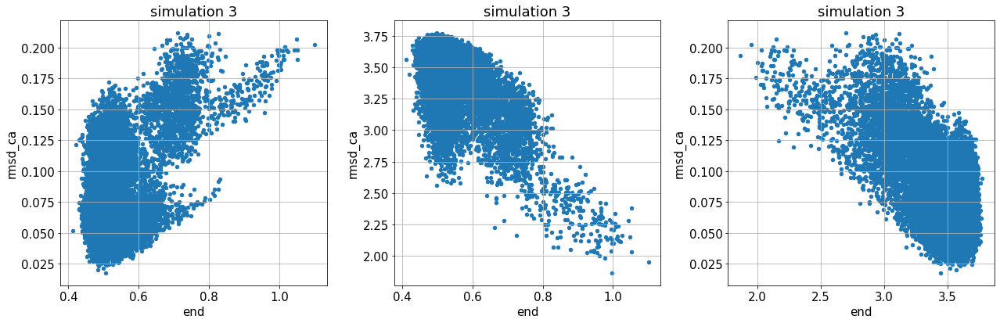

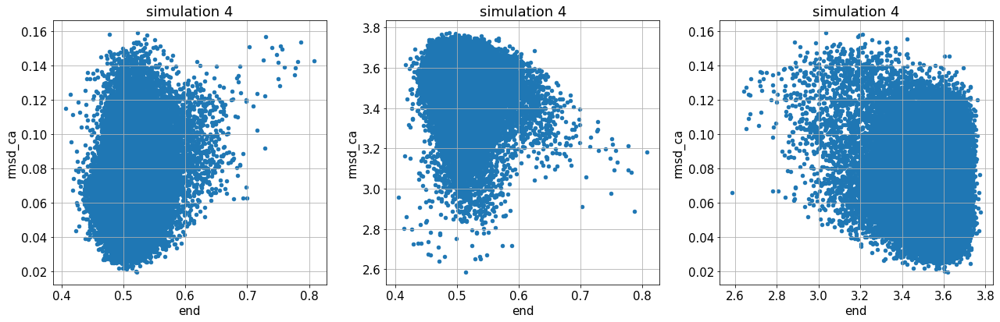

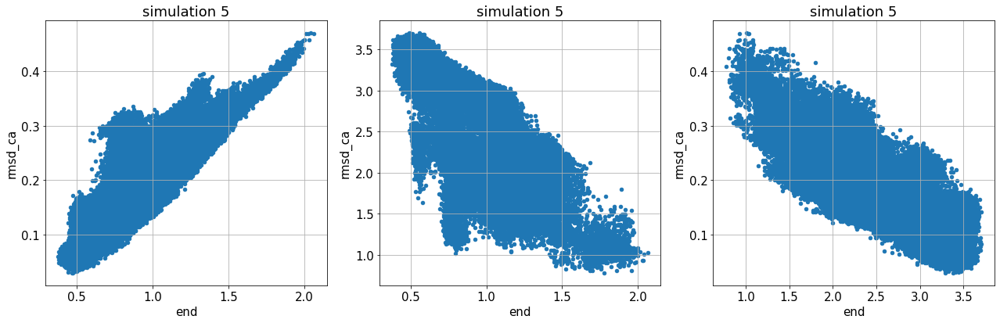

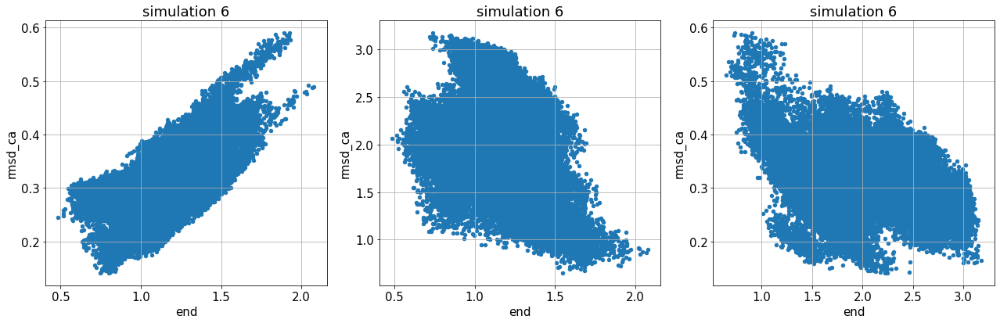

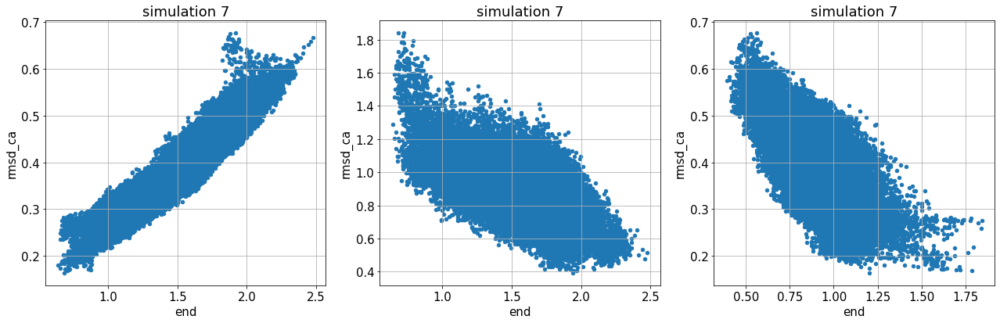

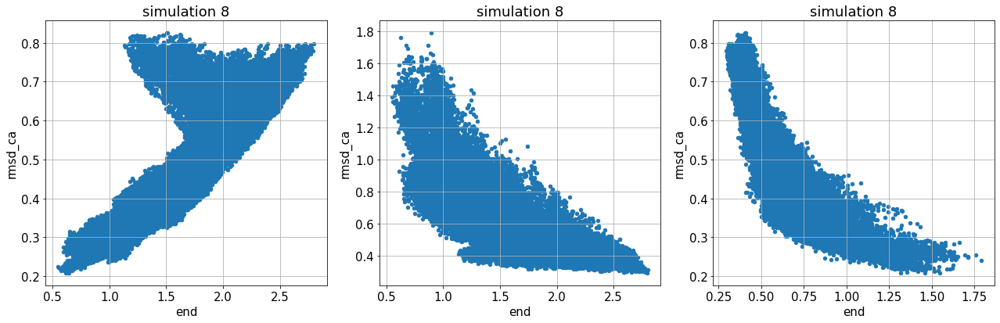

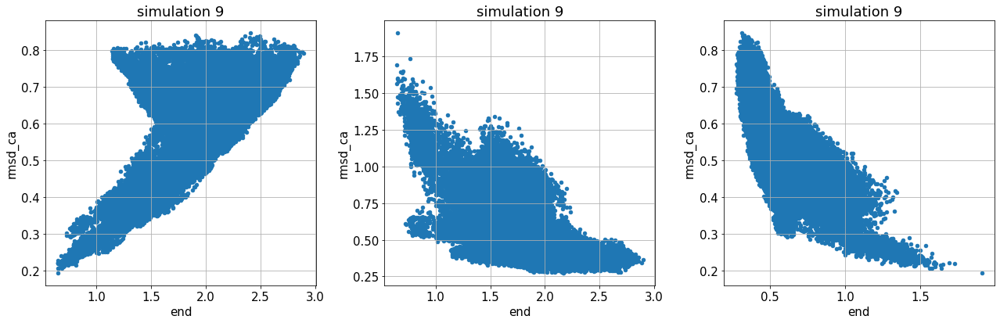

In [4]:
#fig,ax = plt.subplots(1,1,figsize=(10,8))
#color = ["b","r","g","orange"]
for k,set in enumerate(List):

    fig,ax = plt.subplots(1,3,figsize=(18,6))
    data = load_dataframe(set+"COLVAR") 
    descriptors_names = data.filter(regex='^dd_[^a-z]').columns.values

#rmsd_ca end hbonds
    data.plot.scatter(y="rmsd_ca",x="end",ax=ax[0])
    ax[0].grid()
    ax[0].set_title("simulation "+str(k))
    ax[0].set_ylabel("rmsd_ca")
    ax[0].set_xlabel("end")

    #rmsd_ca end hbonds
    data.plot.scatter(y="hbonds",x="end",ax=ax[1])
    ax[1].grid()
    ax[1].set_title("simulation "+str(k))
    ax[1].set_ylabel("rmsd_ca")
    ax[1].set_xlabel("end")

    #rmsd_ca end hbonds
    data.plot.scatter(y="rmsd_ca",x="hbonds",ax=ax[2])
    ax[2].grid()
    ax[2].set_title("simulation "+str(k))
    ax[2].set_ylabel("rmsd_ca")
    ax[2].set_xlabel("end")

    #fig.savefig(root+"images/traj_bias"+str(k)+".png",dpi=300,facecolor="white",transparent=False)
    plt.tight_layout()
    fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/DEEP/bias"+str(k)+".png",dpi=300,facecolor="white",transparent=False)

In [5]:
n_output = 5
layers =[len(descriptors_names),60,30,n_output]

In [6]:
'''
data = load_dataframe(List[0]+"COLVAR")
model = DeepTICA_CV(layers=layers,activation='tanh')
model.load_checkpoint(set+"deeptica/model_checkpoint.pt")
X = data[descriptors_names].to_numpy()
Mean_descriptors = data[descriptors_names].mean()
print(Mean_descriptors.shape) 
weights = []
biases = []
k=0
for name ,param in model.named_parameters():
    #print(name,":\t", param.detach().numpy())
    if k%2==0:
        weights.append(param.detach().numpy())
    else:
        biases.append(param.detach().numpy())
    k+=1
'''

'\ndata = load_dataframe(List[0]+"COLVAR")\nmodel = DeepTICA_CV(layers=layers,activation=\'tanh\')\nmodel.load_checkpoint(set+"deeptica/model_checkpoint.pt")\nX = data[descriptors_names].to_numpy()\nMean_descriptors = data[descriptors_names].mean()\nprint(Mean_descriptors.shape) \nweights = []\nbiases = []\nk=0\nfor name ,param in model.named_parameters():\n    #print(name,":\t", param.detach().numpy())\n    if k%2==0:\n        weights.append(param.detach().numpy())\n    else:\n        biases.append(param.detach().numpy())\n    k+=1\n'

In [7]:
'''
import re

features_w = np.empty(0)
standard_dev = np.empty(0)
couples = []
for i,name in enumerate(descriptors_names):
    couples.append(re.findall('[0-9]+', name))
    features_w = np.append(features_w,np.abs(weights[0].T[i]).sum())
    standard_dev = np.append(standard_dev,data[name].std())  
features = pd.DataFrame(columns=["relevance","names"])
features["relevance"] = features_w*standard_dev
features["relevance"] /= features["relevance"].max()
features["names"] = descriptors_names
#print(features.head())
print(len(features[features["relevance"]>0.5]))
#features[features["relevance"]>0.5].plot.bar(x="names",y="relevance",figsize=(25,8),rot=5)
'''

'\nimport re\n\nfeatures_w = np.empty(0)\nstandard_dev = np.empty(0)\ncouples = []\nfor i,name in enumerate(descriptors_names):\n    couples.append(re.findall(\'[0-9]+\', name))\n    features_w = np.append(features_w,np.abs(weights[0].T[i]).sum())\n    standard_dev = np.append(standard_dev,data[name].std())  \nfeatures = pd.DataFrame(columns=["relevance","names"])\nfeatures["relevance"] = features_w*standard_dev\nfeatures["relevance"] /= features["relevance"].max()\nfeatures["names"] = descriptors_names\n#print(features.head())\nprint(len(features[features["relevance"]>0.5]))\n#features[features["relevance"]>0.5].plot.bar(x="names",y="relevance",figsize=(25,8),rot=5)\n'

In [8]:
'''
with open("plumed-descriptors","w") as file:
    for i,name in enumerate(features[features["relevance"]>0.5]["names"]):
        print(name+": DISTANCE ATOMS="+couples[i][0]+","+couples[i][1],file=file)
'''

'\nwith open("plumed-descriptors","w") as file:\n    for i,name in enumerate(features[features["relevance"]>0.5]["names"]):\n        print(name+": DISTANCE ATOMS="+couples[i][0]+","+couples[i][1],file=file)\n'

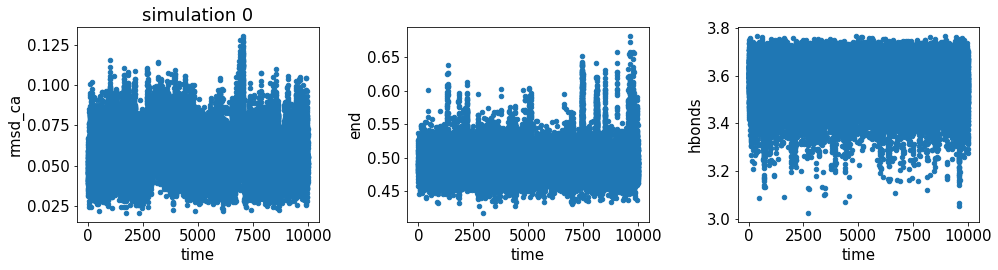

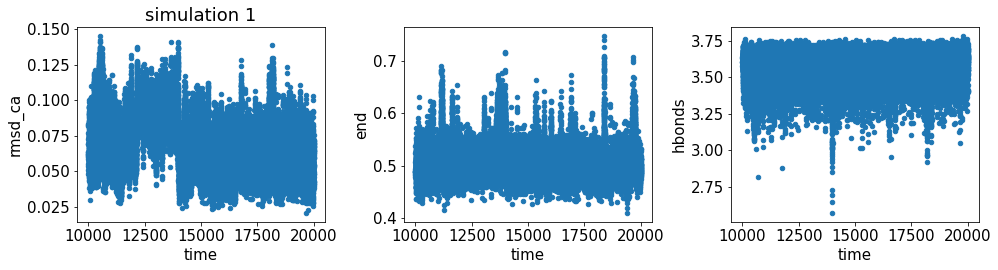

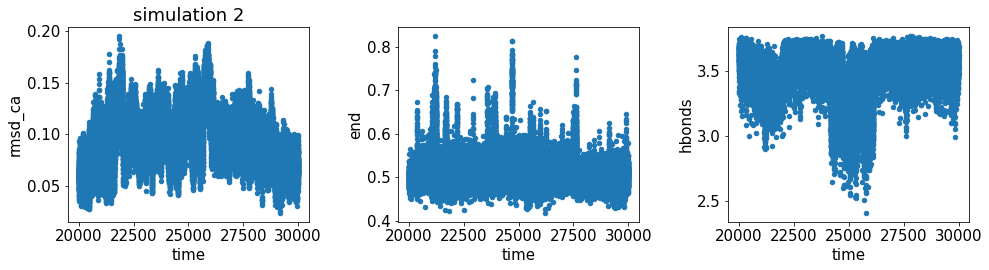

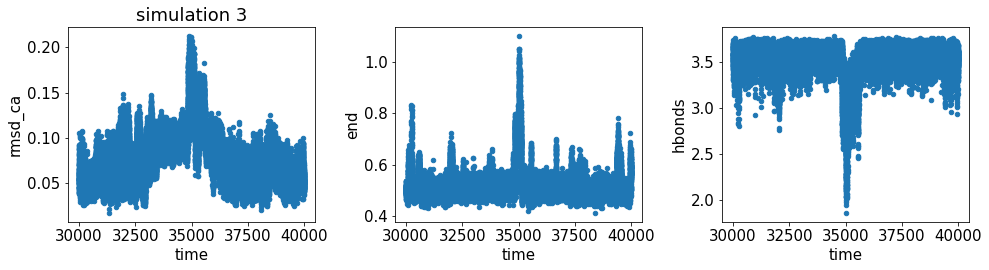

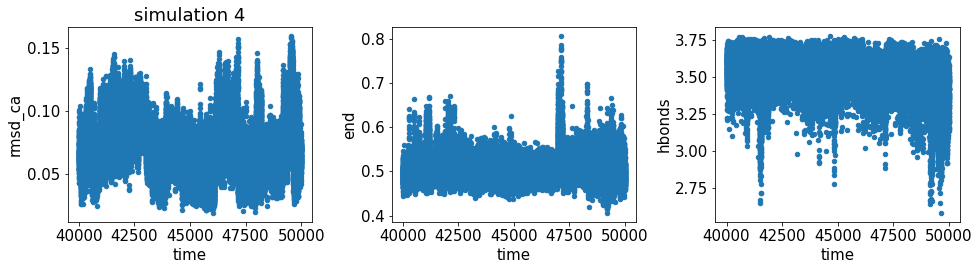

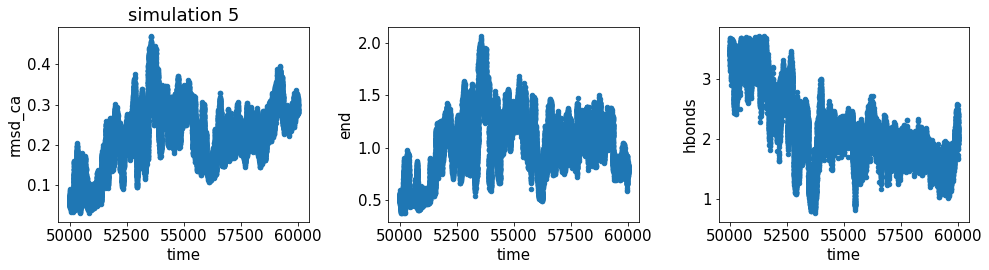

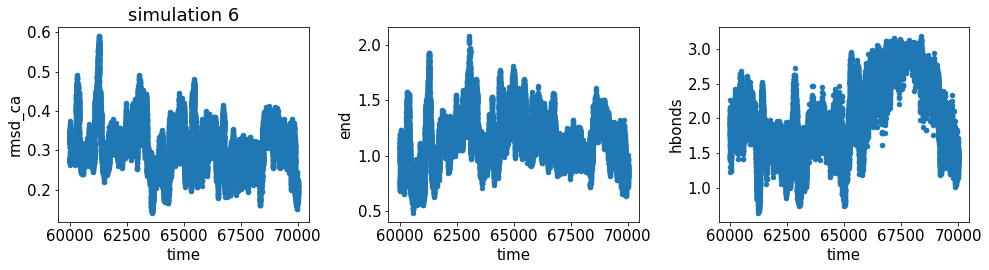

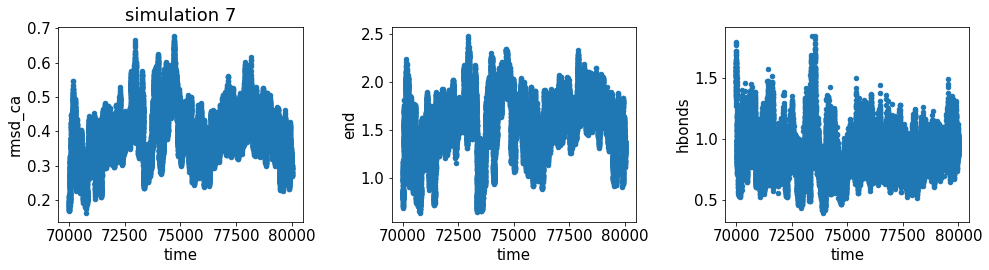

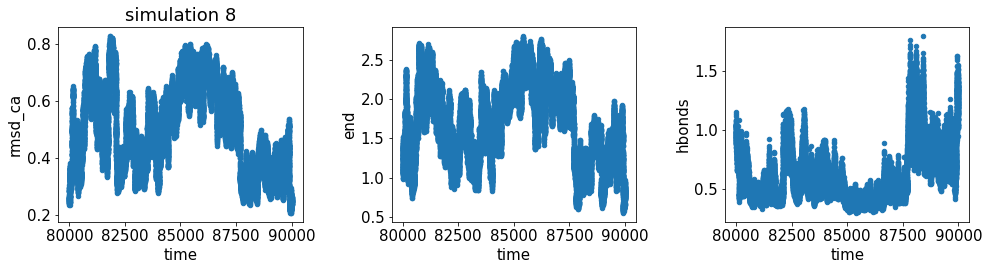

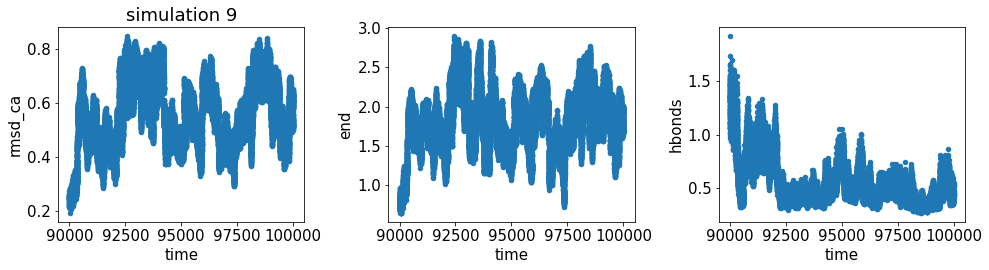

In [9]:
#fig,axs = plt.subplots(1,2,figsize=(16,6))
for k,set in enumerate(List):
    fig,axs = plt.subplots(1,3,figsize=(14,4))
    data = load_dataframe(set+"COLVAR")
    data.plot.scatter(x="time",y="rmsd_ca",ax=axs[0])#, color=color[k])
    data.plot.scatter(x="time",y="end",ax=axs[1])#, color=color[k])
    data.plot.scatter(x="time",y="hbonds",ax=axs[2])

    axs[0].set_title("simulation "+str(k))
    plt.tight_layout()
    fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/DEEP/timeseries_bias"+str(k)+".png",dpi=300,facecolor="white",transparent=False)

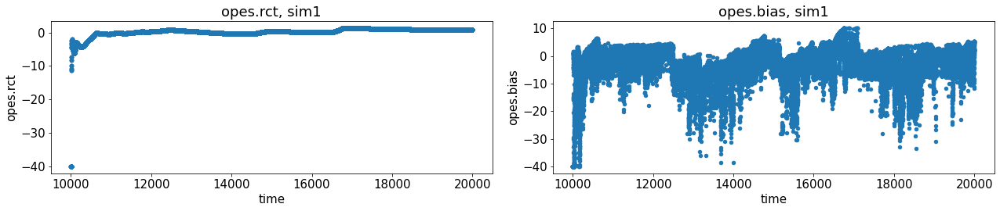

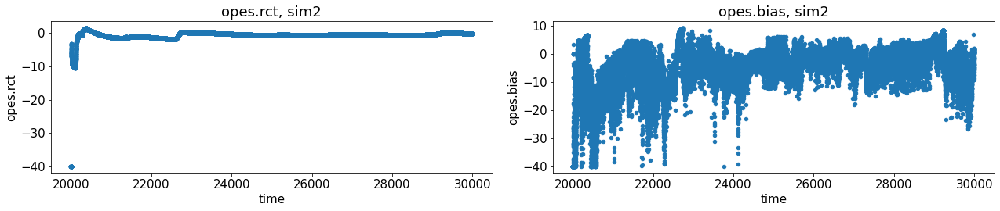

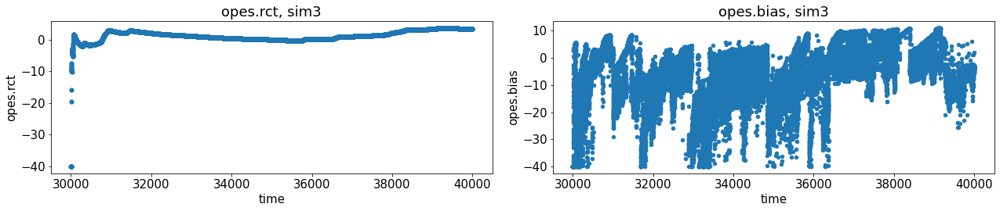

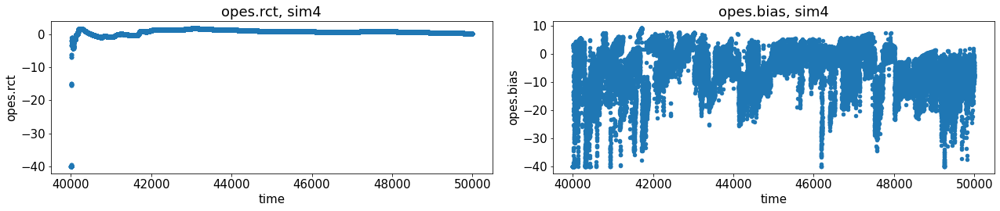

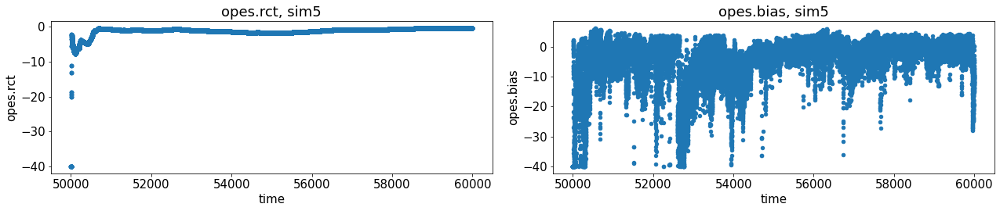

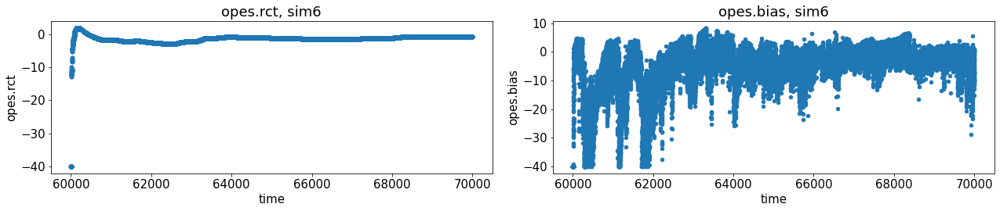

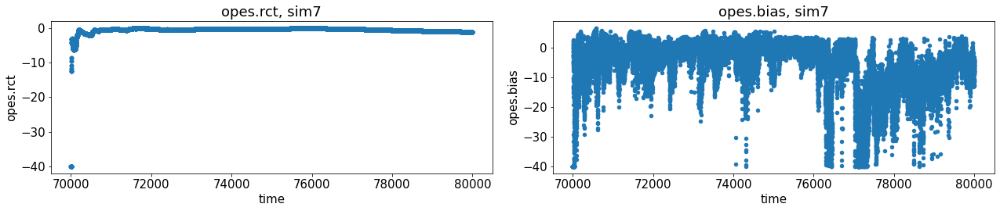

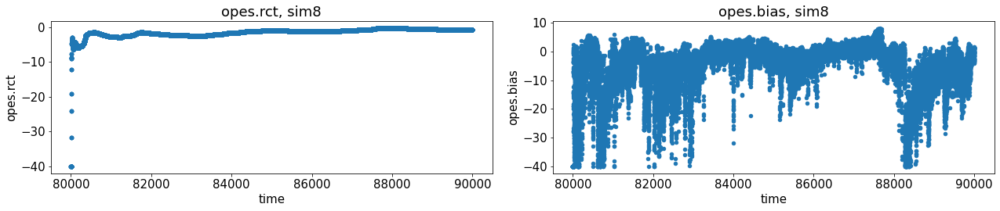

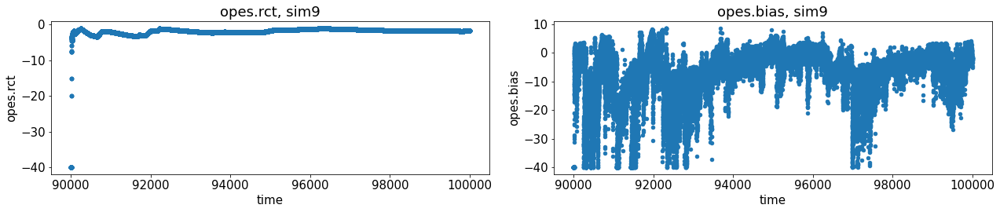

In [10]:
#-- opes rct and opes.bias --#
for k,set in enumerate(List[1:]):
    fig,axs = plt.subplots(1,2,figsize=(18,4))
    data = load_dataframe(set+"COLVAR")
    data.plot.scatter(x="time",y="opes.rct",ax=axs[0])#, color=color[k])
    data.plot.scatter(x="time",y="opes.bias",ax=axs[1])#, color=color[k])

    axs[0].set_title("opes.rct, sim"+str(k+1))
    axs[1].set_title("opes.bias, sim"+str(k+1))
    plt.tight_layout()

In [11]:
# variance and mean of cvs
for k,set in enumerate(List[1:]):
    data = load_dataframe(set+"COLVAR")
    cv = data["deep"+str(k)+".node-0"].values
    logweight = data["opes.bias"].to_numpy()-max(data["opes.bias"].to_numpy())*sim_parameters["beta"]
    mean = np.average(cv)#,weights=np.exp(logweight))
    variance = np.cov(cv)#,aweights=np.exp(logweight))
    print("average: ", mean, "\tvariance: ", variance)

average:  -0.22362200827003853 	variance:  0.30051570240177317
average:  0.1842335705003116 	variance:  0.2833721272145666
average:  0.25448365813125134 	variance:  0.26730284257030335
average:  -0.18491319398350192 	variance:  0.13037386119759897
average:  -0.20789392364850506 	variance:  0.23618437105208784
average:  -0.12778939169780001 	variance:  0.20543146534998044
average:  -0.26459061944219425 	variance:  0.23049061191771802
average:  -0.18754621862506057 	variance:  0.141248065055772
average:  -0.09804659340159 	variance:  0.2758781638210673


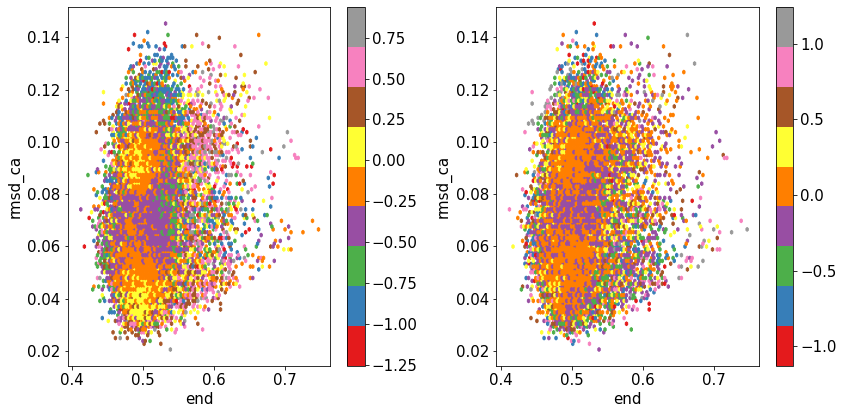

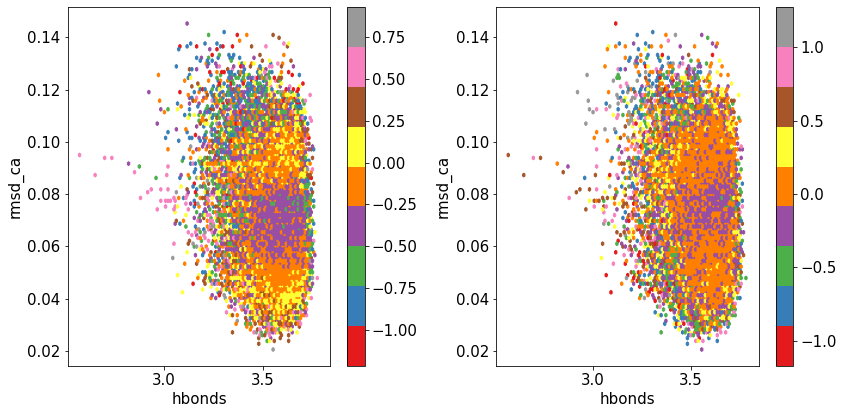

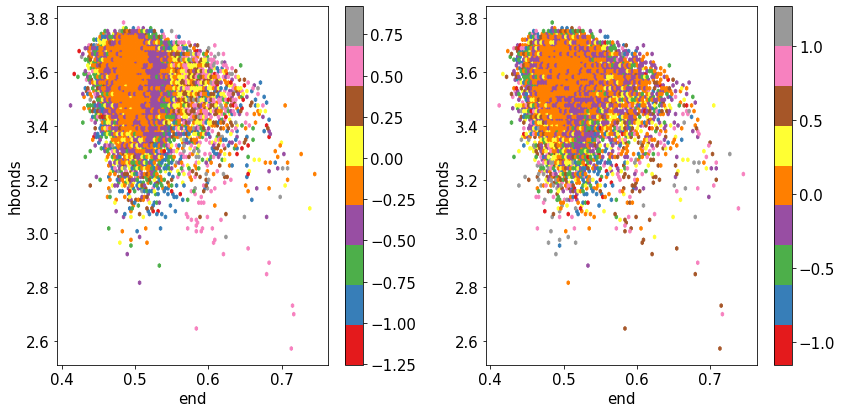

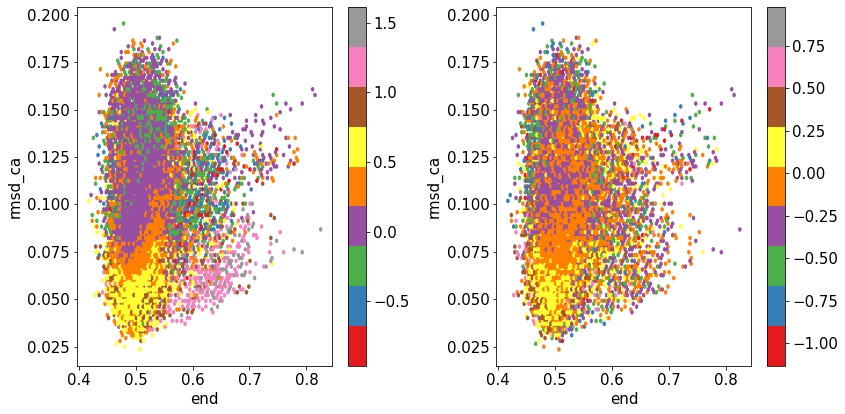

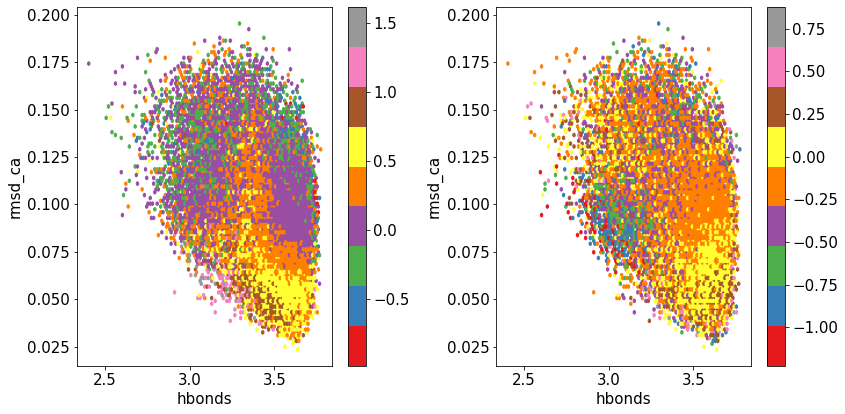

...

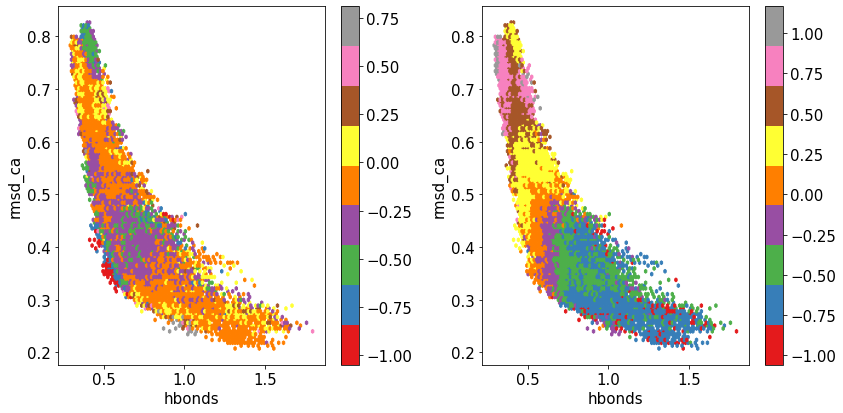

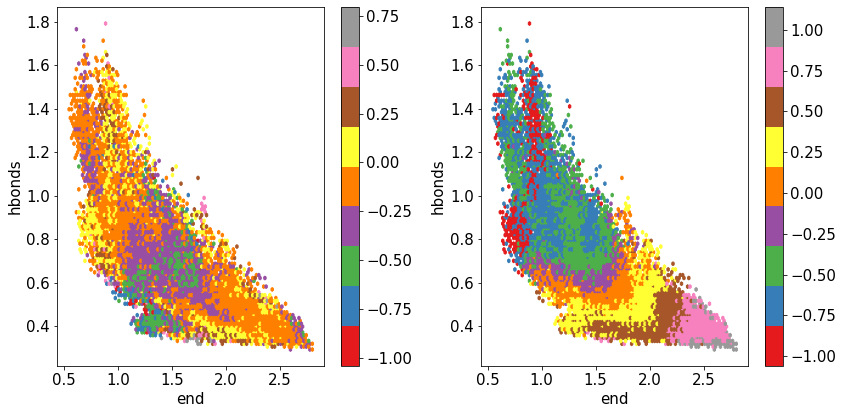

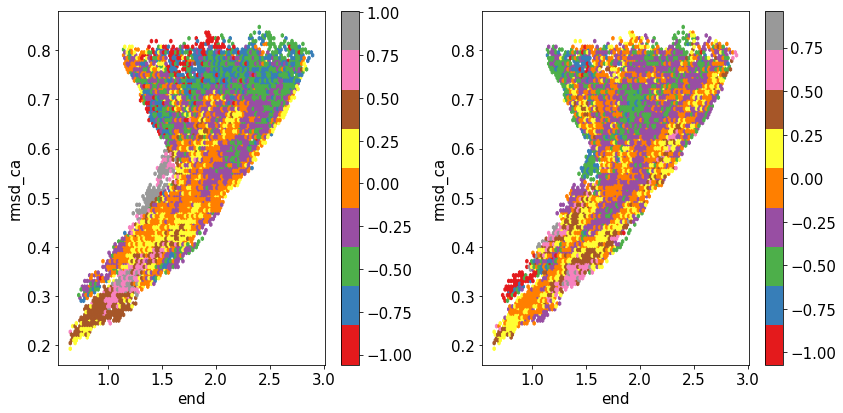

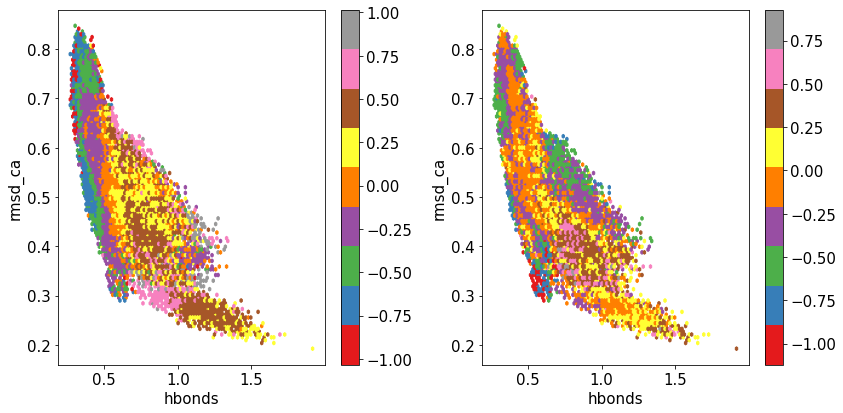

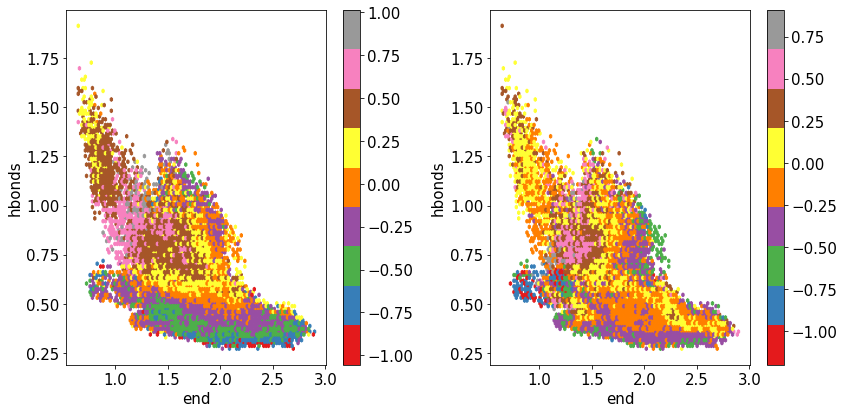

In [12]:
# hexbin, after simulations
for k,set in enumerate(List[1:]):
    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data = load_dataframe(set+"COLVAR")
    
    data.plot.hexbin(y="rmsd_ca",x="end",C="deep"+str(k)+".node-0",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="rmsd_ca",x="end",C="deep"+str(k)+".node-1",cmap="fessa",ax=ax[1])
    plt.tight_layout()
    ax[0].set_title("simulation "+str(k+1))

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.hexbin(y="rmsd_ca",x="hbonds",C="deep"+str(k)+".node-0",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="rmsd_ca",x="hbonds",C="deep"+str(k)+".node-1",cmap="fessa",ax=ax[1])
    plt.tight_layout()

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.hexbin(y="hbonds",x="end",C="deep"+str(k)+".node-0",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="hbonds",x="end",C="deep"+str(k)+".node-1",cmap="fessa",ax=ax[1])
    plt.tight_layout()

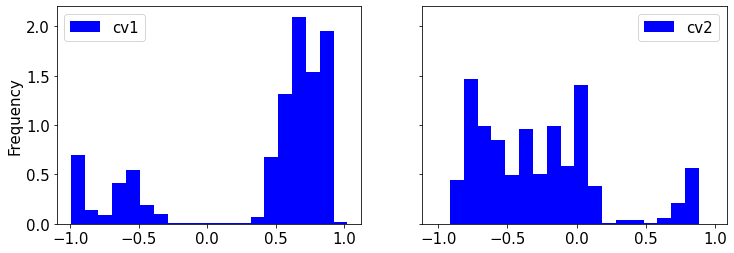

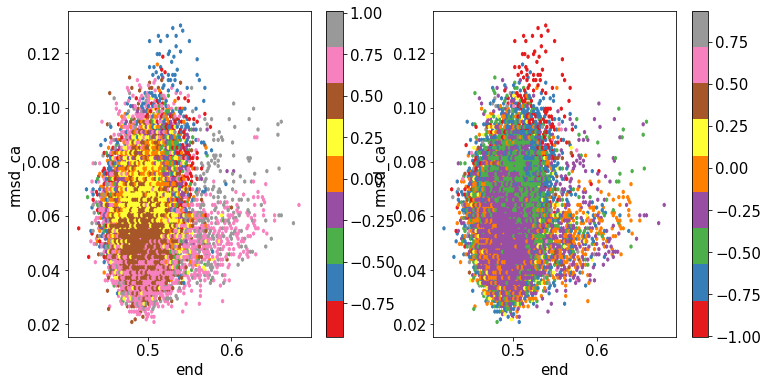

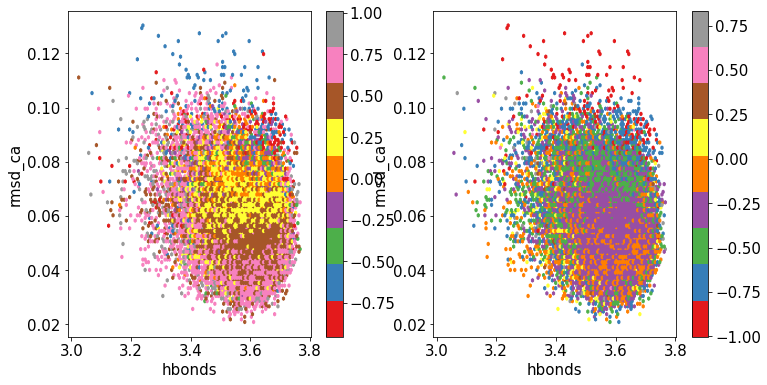

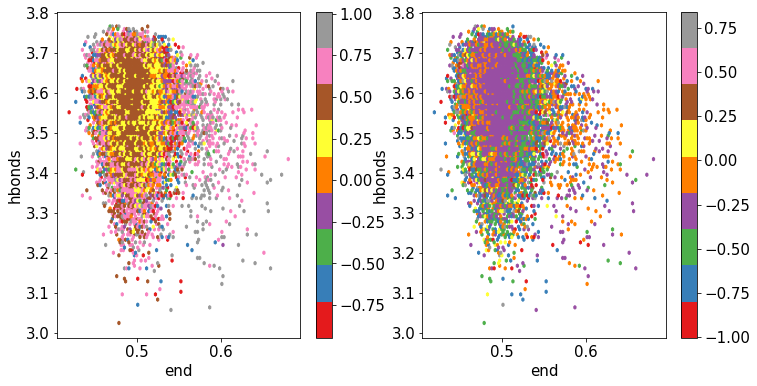

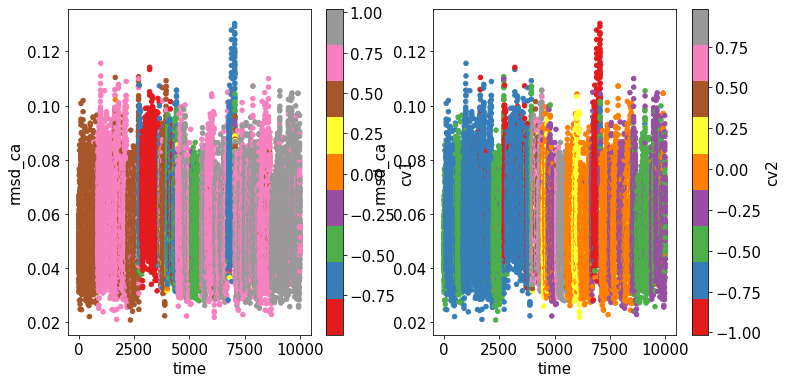

...

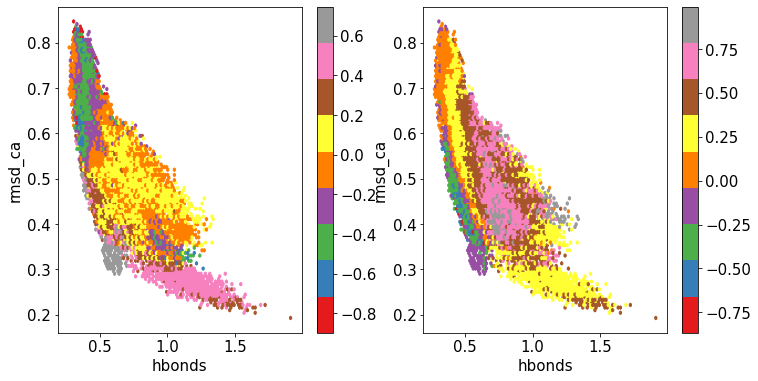

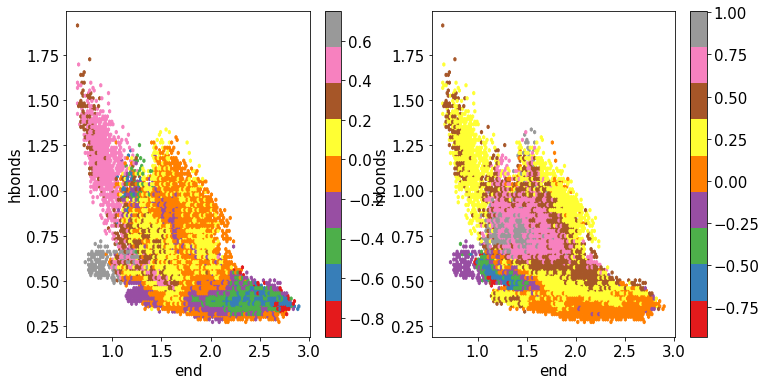

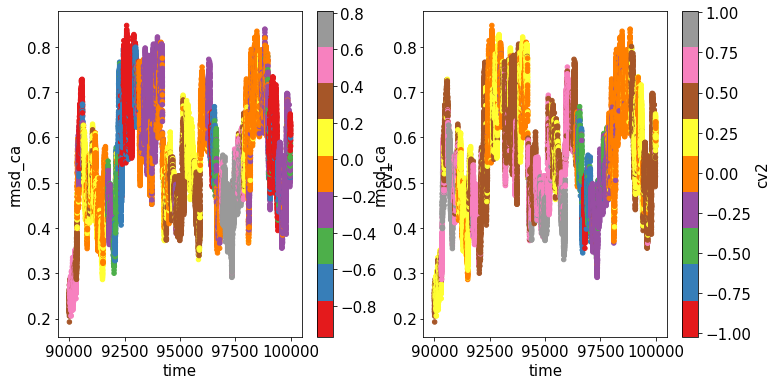

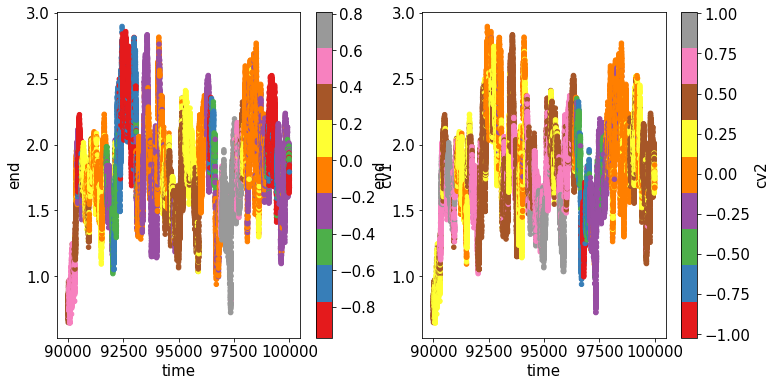

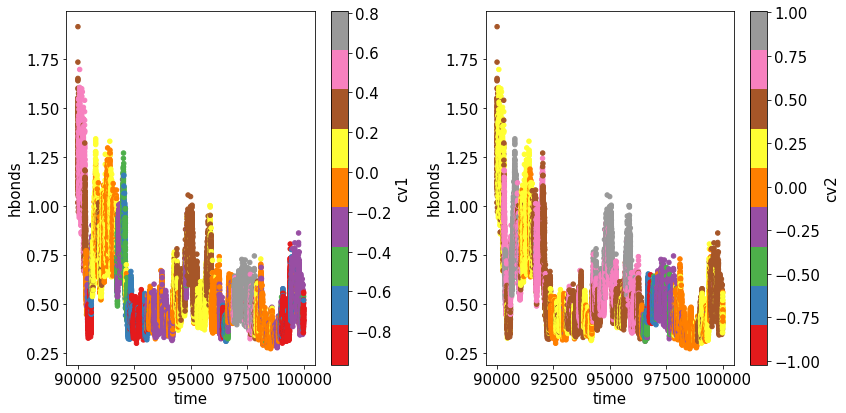

In [13]:
# cvs isolines, before simulations
for k,set in enumerate(List[:]):

    data = load_dataframe(set+"COLVAR")
    model = DeepTICA_CV(layers=layers,activation='tanh')
    model.load_checkpoint(set+"deeptica/model_checkpoint.pt")
    X = data[descriptors_names].to_numpy()
    data["cv1"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[0]
    data["cv2"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[1]

    fig,axs = plt.subplots(1,2,figsize=(12,4),sharey=True)
    data.plot.hist(y="cv1",bins=20,ax=axs[0],density=True,color="b")
    data.plot.hist(y="cv2",bins=20,ax=axs[1],density=True,color="b")

    # hexbin
    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.hexbin(y="rmsd_ca",x="end",C="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="rmsd_ca",x="end",C="cv2",cmap="fessa",ax=ax[1])

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.hexbin(y="rmsd_ca",x="hbonds",C="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="rmsd_ca",x="hbonds",C="cv2",cmap="fessa",ax=ax[1])

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.hexbin(y="hbonds",x="end",C="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.hexbin(y="hbonds",x="end",C="cv2",cmap="fessa",ax=ax[1])

    # time series colored
    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.scatter(y="rmsd_ca",x="time",c="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.scatter(y="rmsd_ca",x="time",c="cv2",cmap="fessa",ax=ax[1])

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.scatter(y="end",x="time",c="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.scatter(y="end",x="time",c="cv2",cmap="fessa",ax=ax[1])

    fig,ax = plt.subplots(1,2,figsize=(12,6))
    data.plot.scatter(y="hbonds",x="time",c="cv1",cmap="fessa",ax=ax[0])#,ax=axs[k])
    data.plot.scatter(y="hbonds",x="time",c="cv2",cmap="fessa",ax=ax[1])

    plt.tight_layout()

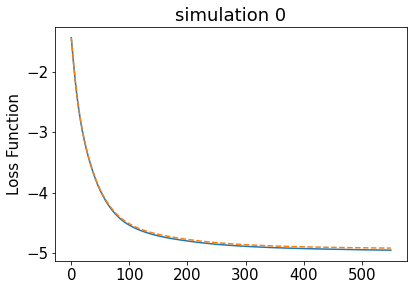

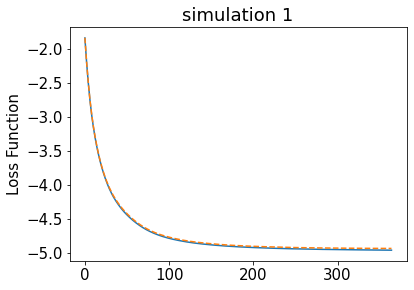

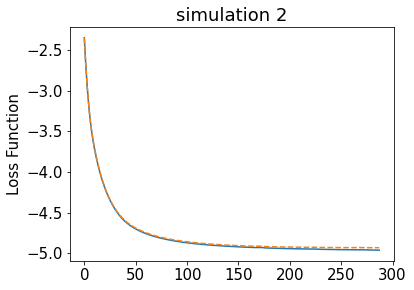

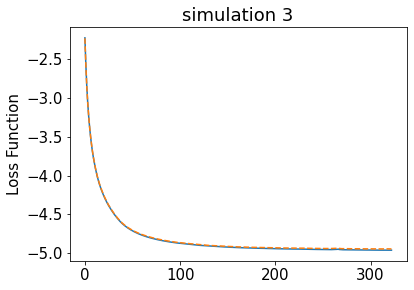

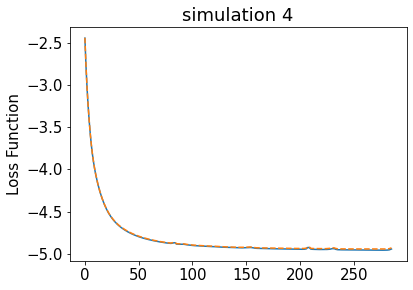

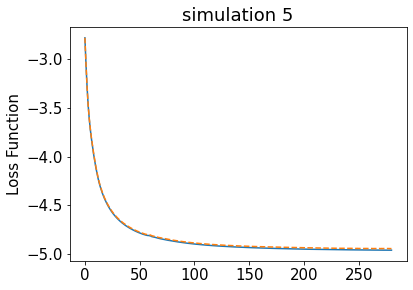

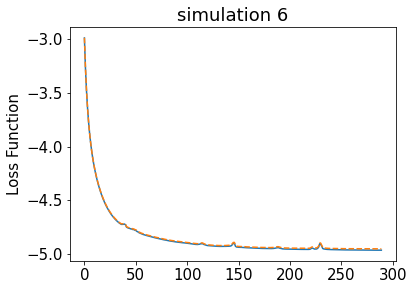

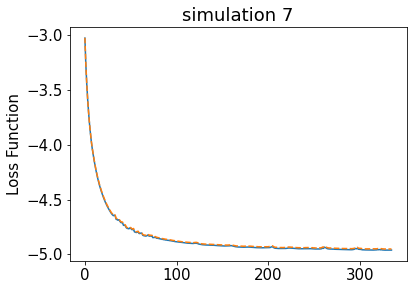

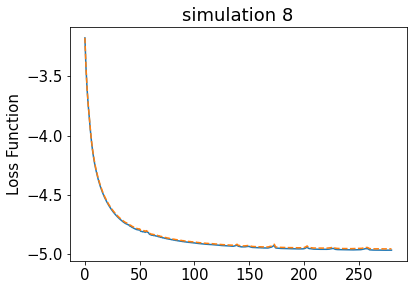

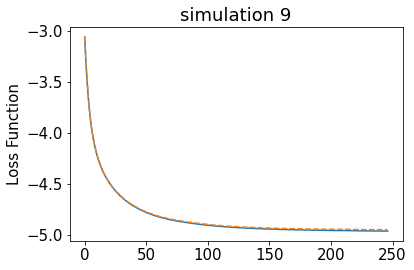

In [14]:
# different loss functions and trainigs
for k,set in enumerate(List[:]):
    
    model = DeepTICA_CV(layers=layers,activation='tanh')
    model.load_checkpoint(set+"deeptica/model_checkpoint.pt")
    fig, ax = plt.subplots(1,1,figsize=(6,4))#,dpi=100)
    plot_model_lossfunction(model,only_loss=ax)
    ax.set_title("simulation "+str(k))

plt.tight_layout()

### FES estimate from cvs  
Obviously from this first simulation it is not possible to found a cvs that from data are able to distinguish all the possible basins. I recall that our approach is a **data drive approach**.  


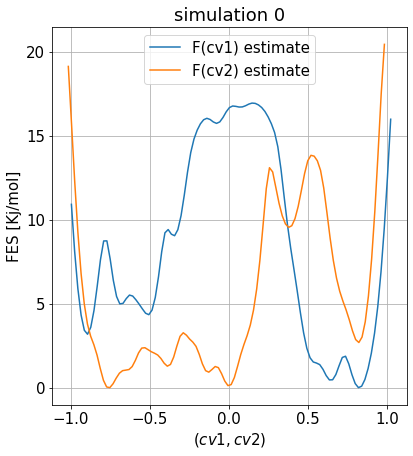

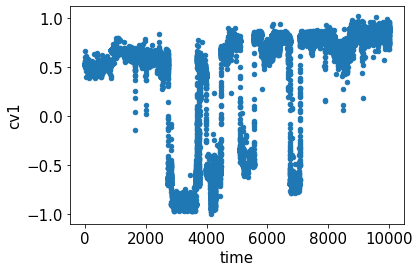

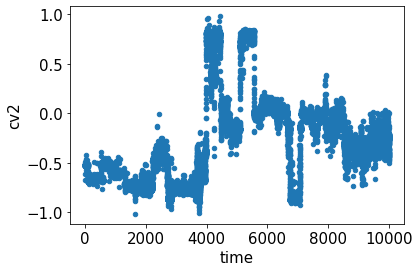

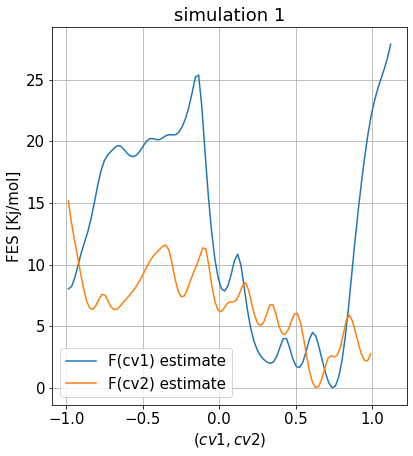

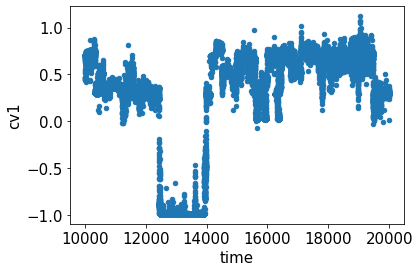

...

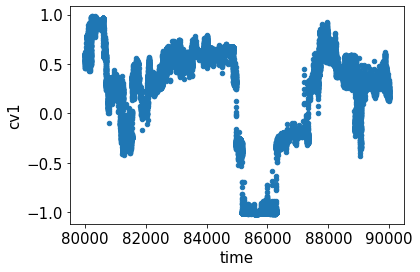

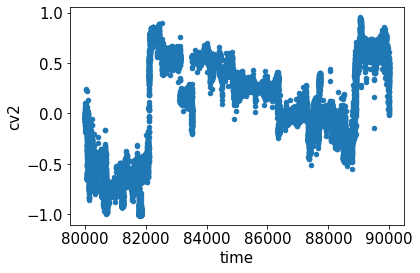

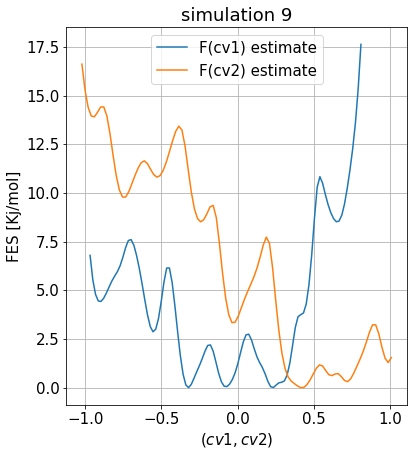

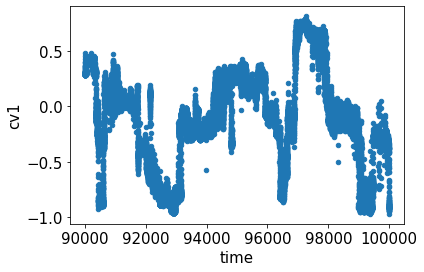

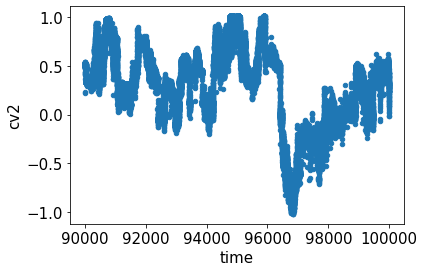

In [15]:
#-- estimation of Free Energy Surface --#
for k,set in enumerate(List[:]):

    data = load_dataframe(set+"COLVAR")
    model = DeepTICA_CV(layers=layers,activation='tanh')
    model.load_checkpoint(set+"deeptica/model_checkpoint.pt")
    X = data[descriptors_names].to_numpy()
    data["cv1"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[0]
    data["cv2"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[1]
    s = data.filter(regex="^cv").to_numpy()
    if k==0:
        logweight = np.zeros(len(data))
    else:
        logweight=( data["opes.bias"].to_numpy()-max(data["opes.bias"].to_numpy()) )*sim_parameters["beta"]
    
    fig, ax = plt.subplots(figsize=(6,6))
    for i in range(2):
        fes,grid,bounds,error = compute_fes(s[:,i], weights=np.exp(logweight),
                                            temp=sim_parameters["temp"],
                                            kbt=sim_parameters["kbt"],
                                            blocks=1,#sim_parameters["blocks"],
                                            bandwidth=sim_parameters["bandwidth"],scale_by='range',
                                            plot=True, ax = ax)
    ax.legend(["F(cv1) estimate","F(cv2) estimate"])   
    ax.grid()
    plt.tight_layout()
    ax.set_title("simulation "+str(k))
    ax.set_xlabel(r"$(cv1,cv2)$")
    ax.set_ylabel("FES [Kj/mol]")

    data.plot.scatter(x="time",y="cv1")
    data.plot.scatter(x="time",y="cv2")
    #data.plot.scatter(x="time",y="deep"+str(k)+".node-0")
    #data.plot.scatter(x="time",y="deep"+str(k)+".node-1")

plt.show()

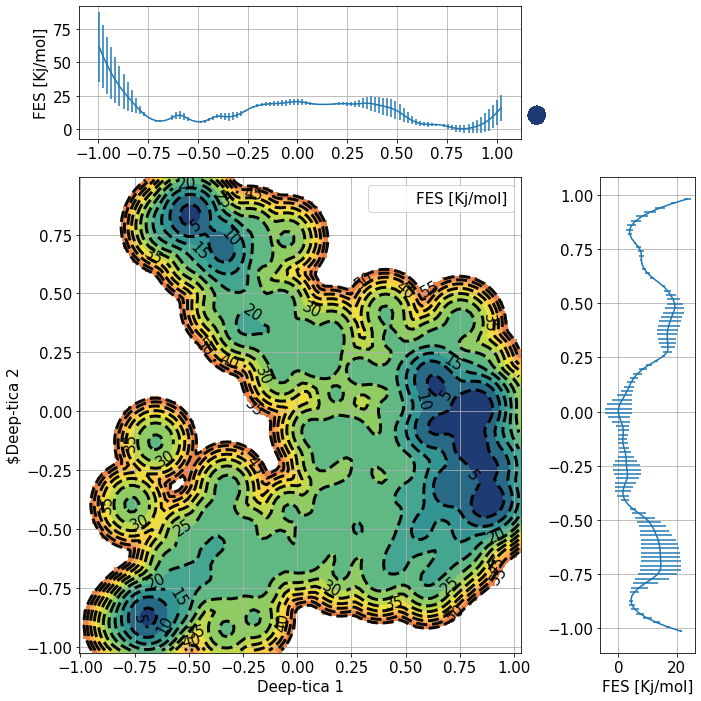

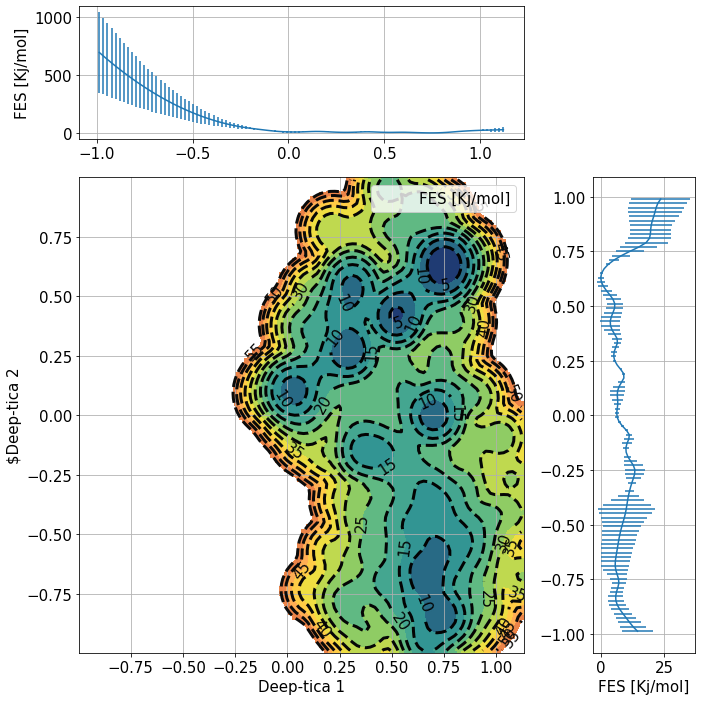

In [16]:
#-- estimation of Free Energy Surface --#
for k,set in enumerate(List[:]):
    data = load_dataframe(set+"COLVAR")
    model = DeepTICA_CV(layers=layers,activation='tanh')
    model.load_checkpoint(set+"deeptica/model_checkpoint.pt")
    X = data[descriptors_names].to_numpy()
    data["cv1"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[0]
    data["cv2"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[1]
    s = data.filter(regex="^cv").to_numpy()
    if k!=0:
        logweight=( data["opes.bias"].to_numpy()-max(data["opes.bias"].to_numpy()) )*sim_parameters["beta"]
    else:
        logweight=np.zeros(len(data))
    gridspec_fes(s,logweight,sim_parameters)
plt.show()

In [ ]:
# estimation of free energy difference along the biased cv0 --#
for k,set in enumerate(List[1:]):

    data = load_dataframe(set+"COLVAR")
    logweight=( data["opes.bias"].to_numpy()-max(data["opes.bias"].to_numpy()) )*sim_parameters["beta"]
    s = data["deep"+str(k)+".node-0"].values

    fes,grid,bounds,error = compute_fes(s, weights=np.exp(logweight),
                                        temp=sim_parameters["temp"],
                                        kbt=sim_parameters["kbt"],
                                        blocks=1,
                                        bandwidth=sim_parameters["bandwidth"],scale_by='range',
                                        plot=False)
    ind1 = (grid<0) 
    ind2 = (grid>0) 
    grid1 = grid[ ind1 ]
    grid2 = grid[ ind2 ] 
    I1 = integrate.trapz(np.exp(-fes[ind1]*sim_parameters["beta"]), grid1)
    I2 = integrate.trapz(np.exp(-fes[ind2]*sim_parameters["beta"]), grid2)
        
    res = (1/sim_parameters["beta"])*np.log(I1/I2)
    print("simulation "+str(k+1))
    print(np.abs(res))

In [ ]:
# time scale with unbiased time -#
fig,axs = plt.subplots(2,1,figsize=(14,10))#,sharey=True)
timescale = np.empty(len(List[1:]))
sims = []
for k,set in enumerate(List[1:]):
    data = load_dataframe(set+"COLVAR")
    #-- in ps --#
    last=1000
    x = np.linspace(0,last+1,last)
    acorr = np.empty(last)
    
    for i in range(last):
        acorr[i] = data["deep"+str(k)+".node-0"].autocorr(i)
    axs[0].plot(x,acorr,label="sim"+str(k+1))
    timescale[k] = integrate.trapz(acorr[:last],x[:last])
    sims.append("sim"+str(k+1))

times = pd.DataFrame(sims,columns=["simulations"])
times["timescale"] = timescale
times.plot(kind="bar",x="simulations",y="timescale",rot=35,ax=axs[1],fontsize=15,label=r"$\xi$")

axs[0].set_xlabel(r'$\tau$')
axs[0].set_title(r'$C(\tau)$')
#axs[0].legend()
axs[1].set_title(r'$\xi=\int d\tau C(\tau)$')

plt.tight_layout()
plt.show()

print(np.max(timescale))
print(np.min(timescale))

# Deep-TICA analysis

In [ ]:
folder = List[-1:][0]
print(folder)
data = load_dataframe(folder+"COLVAR")
size = len(data)
min_lag,max_lag = 0.2,5 #0.2,20
n = 5 # how many lag times between min and max lag
lags = np.linspace(min_lag,max_lag,n)
shuffle = False
train_datasets = []
valid_datasets = []
# torch seed 
torch.manual_seed(21)

#-- TRAINING PARAMETERS --#
n_output = 5
n_input = len(descriptors_names) # can change..
train_parameters = {
              'descriptors': '^dd[^a-z]', # can change during simulation
              'nodes':[n_input,256,256,n_output],
              'activ_type': 'tanh',#'relu','selu','tanh'
              'lag_time':10, 
              'loss_type': 'sum', 
              'n_eig': n_output,
              'trainsize':0.7, 
              'lrate':1e-3,
              'l2_reg':0.,
              'num_epochs':1000,
              'batchsize': -1, #---> è da fare sul train loder and valid loader
              'es_patience':50,
              'es_consecutive':True,
              'standardize_outputs':True,
              'standardize_inputs': True,
              'log_every':50,
              }

print("layers: ",train_parameters["nodes"])
# how many data in single batch, batchsize
n_train = int( size*train_parameters["trainsize"] )
n_valid = int( size*(1-train_parameters["trainsize"])-int(10*max_lag) )
print("training samples: ",n_train, "\t validation samples", n_valid)

# DEVICE
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

t = data['time'].values
X = data[descriptors_names].values

# create time lagged dataset with different lag times
for lag in lags:
    #random split
    # TensorDataset (x_t,x_lag,w_t,w_lag)
    dataset = create_time_lagged_dataset(X,t=t,lag_time=lag,interval=[0,n_train+n_valid])
    train_data, valid_data = random_split(dataset,[n_train,n_valid])
    train_datasets.append(train_data)
    valid_datasets.append(valid_data)

train_loader = FastTensorDataLoader(train_datasets, batch_size=n_train,shuffle=shuffle)
valid_loader = FastTensorDataLoader(valid_datasets, batch_size=n_valid,shuffle=shuffle)

#-- TRAIN --#
# MODEL
model = DeepTICA_CV(train_parameters['nodes'],activation=train_parameters['activ_type'],gaussian_random_initialization=True)
model.to(device)
# OPTIMIZER (Adam)
opt = torch.optim.Adam(model.parameters(), lr=train_parameters['lrate'], weight_decay=train_parameters['l2_reg'])
# lrscheduler
#model.set_LRScheduler(opt,min_lr=5e-5)
model.set_optimizer(opt)
if valid_loader is not None:
    # EarlyStopping
    model.set_earlystopping(patience=train_parameters['es_patience'],
                            min_delta=0.005,consecutive=train_parameters['es_consecutive'], save_best_model=True, log=False) 


In [ ]:
# TRAIN
model.fit(train_loader=train_loader,valid_loader=valid_loader,
    standardize_inputs=train_parameters['standardize_inputs'],
    standardize_outputs=train_parameters['standardize_outputs'],
    loss_type=train_parameters['loss_type'],
    n_eig=train_parameters['n_eig'],
    nepochs=train_parameters['num_epochs'],
    info=False, log_every=train_parameters['log_every'])

In [ ]:
#-- move the model back to cpu for convenience --#
model.to('cpu')
#-- export checkpoint (for loading the model back to python) and torchscript traced module --#
save_folder = folder+"deeptica/"
try:
    os.mkdir(save_folder)
except:
    print("already exists")
#-- move to cpu before saving results --#
model.to("cpu")
model.export(save_folder)

In [ ]:
plot_model_lossfunction(model)

In [ ]:
data["cv1"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[0]
data["cv2"] = np.transpose(model(torch.Tensor(X)).detach().cpu().numpy())[1]

fig,axs = plt.subplots(1,2,figsize=(12,4),sharey=True)
data.plot.hist(y="cv1",bins=20,ax=axs[0],density=True,color="b")
data.plot.hist(y="cv2",bins=20,ax=axs[1],density=True,color="b")

In [ ]:
fig,axs = plt.subplots(1,3,figsize=(14,4))
data.plot.scatter(x="time",y="rmsd_ca",c="cv1",cmap="fessa",ax=axs[0])#, color=color[k])
data.plot.scatter(x="time",y="end",c="cv1",cmap="fessa",ax=axs[1])#, color=color[k])
data.plot.scatter(x="time",y="hbonds",c="cv1",cmap="fessa",ax=axs[2])

plt.tight_layout()
fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/TICA/time_series_lastbias_cv1.png",dpi=300,facecolor="white",transparent=False)

fig,axs = plt.subplots(1,3,figsize=(14,4))
data.plot.scatter(x="time",y="rmsd_ca",c="cv2",cmap="fessa",ax=axs[0])#, color=color[k])
data.plot.scatter(x="time",y="end",c="cv2",cmap="fessa",ax=axs[1])#, color=color[k])
data.plot.scatter(x="time",y="hbonds",c="cv2",cmap="fessa",ax=axs[2])

plt.tight_layout()

fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/DEEP/time_series_lastbias_cv2.png",dpi=300,facecolor="white",transparent=False)

In [ ]:
fig,axs = plt.subplots(1,3,figsize=(18,6))
    
#rmsd_ca end hbonds
data.plot.hexbin(y="rmsd_ca",x="end",C="cv1",cmap="fessa",ax=axs[0])
axs[0].grid()
axs[0].set_ylabel("rmsd_ca")
axs[0].set_xlabel("end")

data.plot.hexbin(y="rmsd_ca",x="hbonds",C="cv1",cmap="fessa",ax=axs[1])
axs[1].grid()
axs[1].set_ylabel("rmsd_ca")
axs[1].set_xlabel("hbonds")

data.plot.hexbin(y="hbonds",x="end",C="cv1",cmap="fessa",ax=axs[2])
axs[2].grid()
axs[2].set_ylabel("hbonds")
axs[2].set_xlabel("end")

plt.tight_layout()

fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/DEEP/traj_lastbias_cv1.png",dpi=300,facecolor="white",transparent=False)

In [ ]:
fig,axs = plt.subplots(1,3,figsize=(18,6))
    
#rmsd_ca end hbonds
data.plot.hexbin(y="rmsd_ca",x="end",C="cv2",cmap="fessa",ax=axs[0])
axs[0].grid()
axs[0].set_ylabel("rmsd_ca")
axs[0].set_xlabel("end")

data.plot.hexbin(y="rmsd_ca",x="hbonds",C="cv2",cmap="fessa",ax=axs[1])
axs[1].grid()
axs[1].set_ylabel("rmsd_ca")
axs[1].set_xlabel("hbonds")

data.plot.hexbin(y="hbonds",x="end",C="cv2",cmap="fessa",ax=axs[2])
axs[2].grid()
axs[2].set_ylabel("hbonds")
axs[2].set_xlabel("end")

plt.tight_layout()

fig.savefig("/home/npedrani@iit.local/Desktop/simulation_images/chignolin_onthefly_tica/DEEP/traj_lastbias_cv2.png",dpi=300,facecolor="white",transparent=False)